# <a id='toc1_'></a>[Using SDXL 1.0 with AWS JumpStart](#toc0_)


--------------------

## <font color='orange'>Important:</font>

Please visit model detail page in <a href="https://aws.amazon.com/marketplace/pp/prodview-pe7wqwehghdtm">https://aws.amazon.com/marketplace/pp/prodview-pe7wqwehghdtm</a> to learn more. <font color='orange'>If you do not have access to the link, please contact account admin for the help.</font>

You will find details about the model including pricing, supported region, and end user license agreement. To use the model, please click “<font color='orange'>Continue to Subscribe</font>” from the detail page, come back here and learn how to deploy and inference.

-------------------



This sample notebook shows you how to deploy Stable Diffusion SDXL 1.0 from Stability AI as an endpoint on Amazon SageMaker.

> **Note**: This is a reference notebook and it cannot run unless you make changes suggested in the notebook.


## <a id='toc1_1_'></a>[Prerequisites](#toc0_)

1. **Note**: Open this notebook from an Amazon SageMaker Notebook Instance or Amazon SageMaker Studio.

1. Ensure that IAM role used has **AmazonSageMakerFullAccess**

1. To deploy the ML model successfully using the steps in this notebook, ensure that either:
    1. Your IAM role has the following three permissions and you have authority to make AWS Marketplace subscriptions in the AWS account used: 
        1. **aws-marketplace:ViewSubscriptions**
        1. **aws-marketplace:Unsubscribe**
        1. **aws-marketplace:Subscribe**  
    2. Or your AWS account has a subscription to [the SDXL 1.0 Jumpstart](https://aws.amazon.com/marketplace/pp/prodview-pe7wqwehghdtm). If so, skip step: [Subscribe to the model package](#1.-Subscribe-to-the-model-package) 




## <a id='toc1_2_'></a>[Resources](#toc0_)


1. [Stability SDK documentation](https://api.stability.ai/docs#tag/v1generation)

2. [Documentation on real-time inference with Amazon SageMaker](https://docs.aws.amazon.com/sagemaker/latest/dg/how-it-works-hosting.html).


## <a id='toc1_3_'></a>[Usage instructions](#toc0_)
You can run this notebook one cell at a time (By using Shift+Enter for running a cell).


   
- [1. Subscribe to the SDXL Model Package](#toc3_)    
- [2: Create an endpoint and perform real-time inference](#toc4_)    
  - [A: Text to image](#toc4_1_)    
  - [B: Image to image](#toc4_2_)    
- [3: Delete the endpoint](#toc5_)    

<!-- vscode-jupyter-toc-config
	numbering=false
	anchor=true
	flat=false
	minLevel=1
	maxLevel=6
	/vscode-jupyter-toc-config -->
<!-- THIS CELL WILL BE REPLACED ON TOC UPDATE. DO NOT WRITE YOUR TEXT IN THIS CELL -->

# <a id='toc3_'></a>[1. Subscribe to the SDXL Model Package](#toc0_)

To subscribe to the SDXL Model Package:
1. Open the SDXL Model Package listing page: https://aws.amazon.com/marketplace/pp/prodview-pe7wqwehghdtm
1. On the AWS Marketplace listing, click on the **Continue to subscribe** button.
1. On the **Subscribe to this software** page, review and click on **"Accept Offer"** if you and your organization accept the EULA, pricing, and support terms.

In [2]:
!pip install -U 'stability-sdk[sagemaker] @ git+https://github.com/Stability-AI/stability-sdk.git@sagemaker'
! pip install protobuf==3.20


import sagemaker
from sagemaker import ModelPackage, get_execution_role
from stability_sdk_sagemaker.predictor import StabilityPredictor
from stability_sdk_sagemaker.models import get_model_package_arn
from stability_sdk.api import GenerationRequest, GenerationResponse, TextPrompt

from PIL import Image
from typing import Union, Tuple
import io
import os
import base64
import boto3

  Cloning https://github.com/Stability-AI/stability-sdk.git (to revision sagemaker) to /tmp/pip-install-b4dum0du/stability-sdk_52d88fe23d1542cf9aef6269572d3739
  Running command git clone --filter=blob:none --quiet https://github.com/Stability-AI/stability-sdk.git /tmp/pip-install-b4dum0du/stability-sdk_52d88fe23d1542cf9aef6269572d3739
  Running command git checkout -b sagemaker --track origin/sagemaker
  Switched to a new branch 'sagemaker'
  Branch 'sagemaker' set up to track remote branch 'sagemaker' from 'origin'.
  Resolved https://github.com/Stability-AI/stability-sdk.git to commit 41773a9366d3bef3d32f59c7ff1d1939fbe5212e
  Running command git submodule update --init --recursive -q
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done

[notice] A new release of pip is available: 23.2.1 -> 23.3.1
[notice] To update, run: pip install --upgrade pip

[notice] A new release of pip is available: 23.2.1 -> 

# <a id='toc4_'></a>[2: Create an endpoint and perform real-time inference](#toc0_)

In [3]:
# Choose your endpoint name
from sagemaker.utils import name_from_base
endpoint_name=name_from_base('sdxl-1-0-jumpstart') # change this as desired


Once you have subscribed to Stability SDXL, get the Model Package ARN using the map below:


In [4]:

model_package_map = {
    "us-east-1": "arn:aws:sagemaker:us-east-1:865070037744:model-package/sdxl-v1-0-8cc703e-43ceeb816ad635d18270e159eb5096ad",
    "us-east-2": "arn:aws:sagemaker:us-east-2:057799348421:model-package/sdxl-v1-0-8cc703e-43ceeb816ad635d18270e159eb5096ad",
    "us-west-2": "arn:aws:sagemaker:us-west-2:594846645681:model-package/sdxl-v1-0-8cc703e-43ceeb816ad635d18270e159eb5096ad",
    "ca-central-1": "arn:aws:sagemaker:ca-central-1:470592106596:model-package/sdxl-v1-0-8cc703e-43ceeb816ad635d18270e159eb5096ad",
    "eu-central-1": "arn:aws:sagemaker:eu-central-1:446921602837:model-package/sdxl-v1-0-8cc703e-43ceeb816ad635d18270e159eb5096ad",
    "eu-west-1": "arn:aws:sagemaker:eu-west-1:985815980388:model-package/sdxl-v1-0-8cc703e-43ceeb816ad635d18270e159eb5096ad",
    "eu-west-2": "arn:aws:sagemaker:eu-west-2:856760150666:model-package/sdxl-v1-0-8cc703e-43ceeb816ad635d18270e159eb5096ad",
    "ap-northeast-2": "arn:aws:sagemaker:ap-northeast-2:745090734665:model-package/sdxl-v1-0-8cc703e-43ceeb816ad635d18270e159eb5096ad",
    "ap-northeast-1": "arn:aws:sagemaker:ap-northeast-1:977537786026:model-package/sdxl-v1-0-8cc703e-43ceeb816ad635d18270e159eb5096ad",
    "ap-south-1": "arn:aws:sagemaker:ap-south-1:077584701553:model-package/sdxl-v1-0-8cc703e-43ceeb816ad635d18270e159eb5096ad"
}


region = boto3.Session().region_name
if region not in model_package_map.keys():
    raise ("UNSUPPORTED REGION")
package_arn = model_package_map[region]  # TODO

role_arn = get_execution_role()
sagemaker_session = sagemaker.Session()

sagemaker.config INFO - Not applying SDK defaults from location: /etc/xdg/sagemaker/config.yaml
sagemaker.config INFO - Not applying SDK defaults from location: /root/.config/sagemaker/config.yaml
sagemaker.config INFO - Not applying SDK defaults from location: /etc/xdg/sagemaker/config.yaml
sagemaker.config INFO - Not applying SDK defaults from location: /root/.config/sagemaker/config.yaml


Create a deployable `ModelPackage`. For SDXL 1.0 use one of the following instances types: ml.g5.2xlarge, ml.p4d.24xlarge, p4de.24xlarge. Specify it as `instance_type` below.


In [6]:
"""
model = ModelPackage(role=role_arn,model_package_arn=package_arn,sagemaker_session=sagemaker_session,predictor_cls=StabilityPredictor)


# Deploy the ModelPackage. This will take 5-10 minutes to run

instance_type="ml.g5.2xlarge" # valid instance types for this model are ml.g5.2xlarge, p4d.24xlarge, and p4de.24xlarge
deployed_model = model.deploy(initial_instance_count=1,instance_type=instance_type,endpoint_name=endpoint_name)
"""

'\nmodel = ModelPackage(role=role_arn,model_package_arn=package_arn,sagemaker_session=sagemaker_session,predictor_cls=StabilityPredictor)\n\n\n# Deploy the ModelPackage. This will take 5-10 minutes to run\n\ninstance_type="ml.g5.2xlarge" # valid instance types for this model are ml.g5.2xlarge, p4d.24xlarge, and p4de.24xlarge\ndeployed_model = model.deploy(initial_instance_count=1,instance_type=instance_type,endpoint_name=endpoint_name)\n'

In [7]:
#%store endpoint_name

%store -r endpoint_name
endpoint_name

'sdxl-1-0-jumpstart-2023-11-02-09-14-17-735'

If you have already deployed your model, you can also access it via your chosen `endpoint_name` and `sagemaker_session`:


In [8]:
deployed_model = StabilityPredictor(endpoint_name=endpoint_name, sagemaker_session=sagemaker_session)


We can call `predict` on our deployed model to return model outputs. For the full list of parameters, [see the Stability.ai SDK documentation.](https://api.stability.ai/docs#tag/v1generation)

## <a id='toc4_1_'></a>[A: Text to image](#toc0_)


In [9]:
output = deployed_model.predict(GenerationRequest(text_prompts=[TextPrompt(text="jaguar in the Amazon rainforest")],
                                             # style_preset="cinematic",
                                             seed = 12345,
                                            width=1024,
                                            height=1024.
                                             ))


Output images are included in the response's `artifacts` as base64 encoded strings. Below is a helper function for accessing decoding these images:

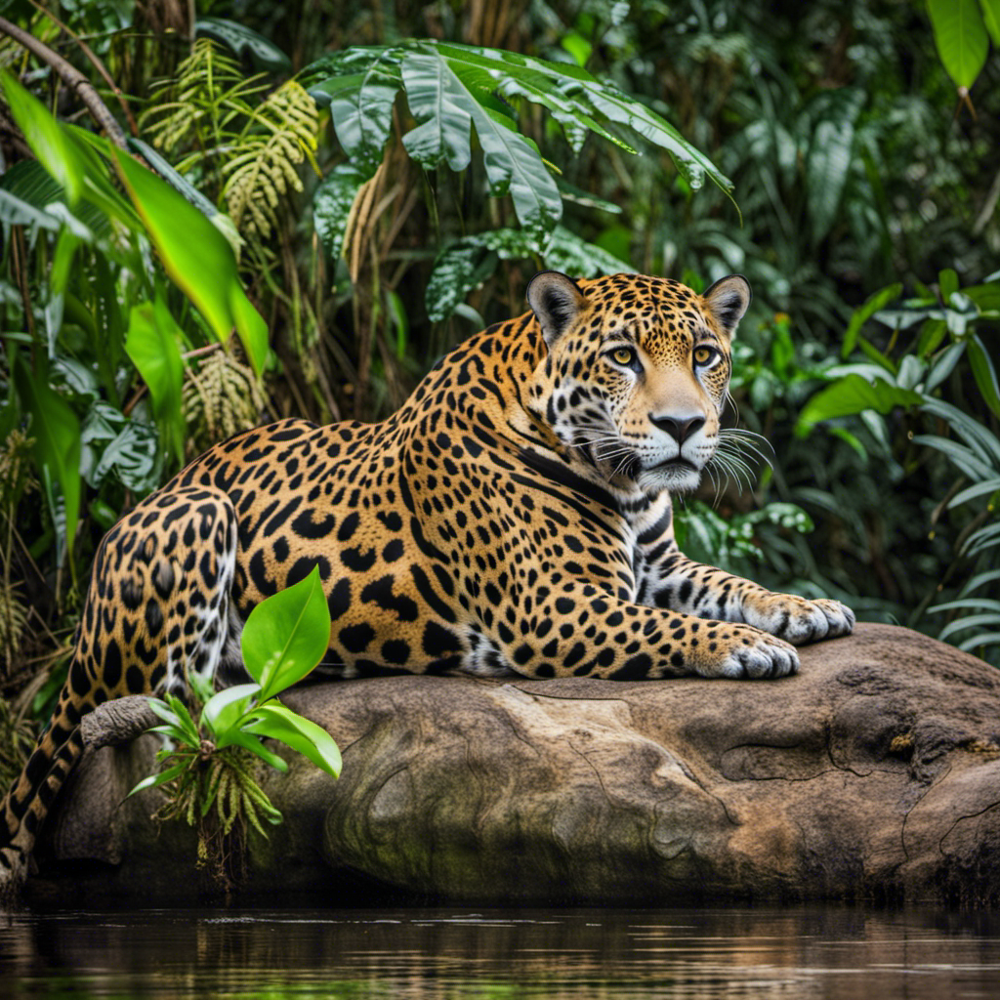

In [10]:
def decode_and_show(model_response: GenerationResponse) -> None:
    """
    Decodes and displays an image from SDXL output

    Args:
        model_response (GenerationResponse): The response object from the deployed SDXL model.

    Returns:
        None
    """
    image = model_response.artifacts[0].base64
    image_data = base64.b64decode(image.encode())
    image = Image.open(io.BytesIO(image_data))
    display(image)

decode_and_show(output)


Available samplers are:
```
“DDIM”,
“DDPM”,
“K_DPMPP_SDE”,
“K_DPMPP_2M”,
“K_DPMPP_2S_ANCESTRAL”,
“K_DPM_2”,
“K_DPM_2_ANCESTRAL”,
“K_EULER”,
“K_EULER_ANCESTRAL”,
“K_HEUN”,
“K_LMS”
```

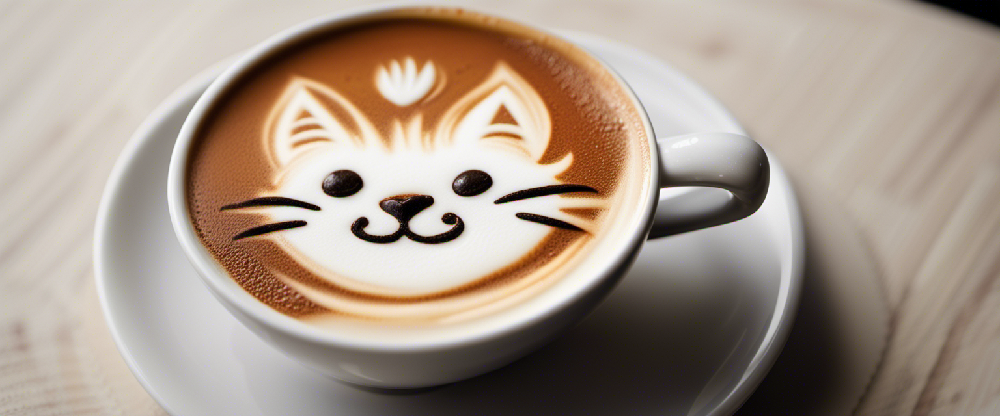

In [11]:
text = "photograph of latte art of a cat"

output = deployed_model.predict(GenerationRequest(text_prompts=[TextPrompt(text=text)],
                                            seed=5,
                                            height=640,
                                            width=1536,
                                            sampler="DDIM",
                                             ))
decode_and_show(output)

Let's try passing in a `style_preset`. See the [Stability SDK documentation](https://api.stability.ai/docs#tag/v1generation) for a full list of available presets.

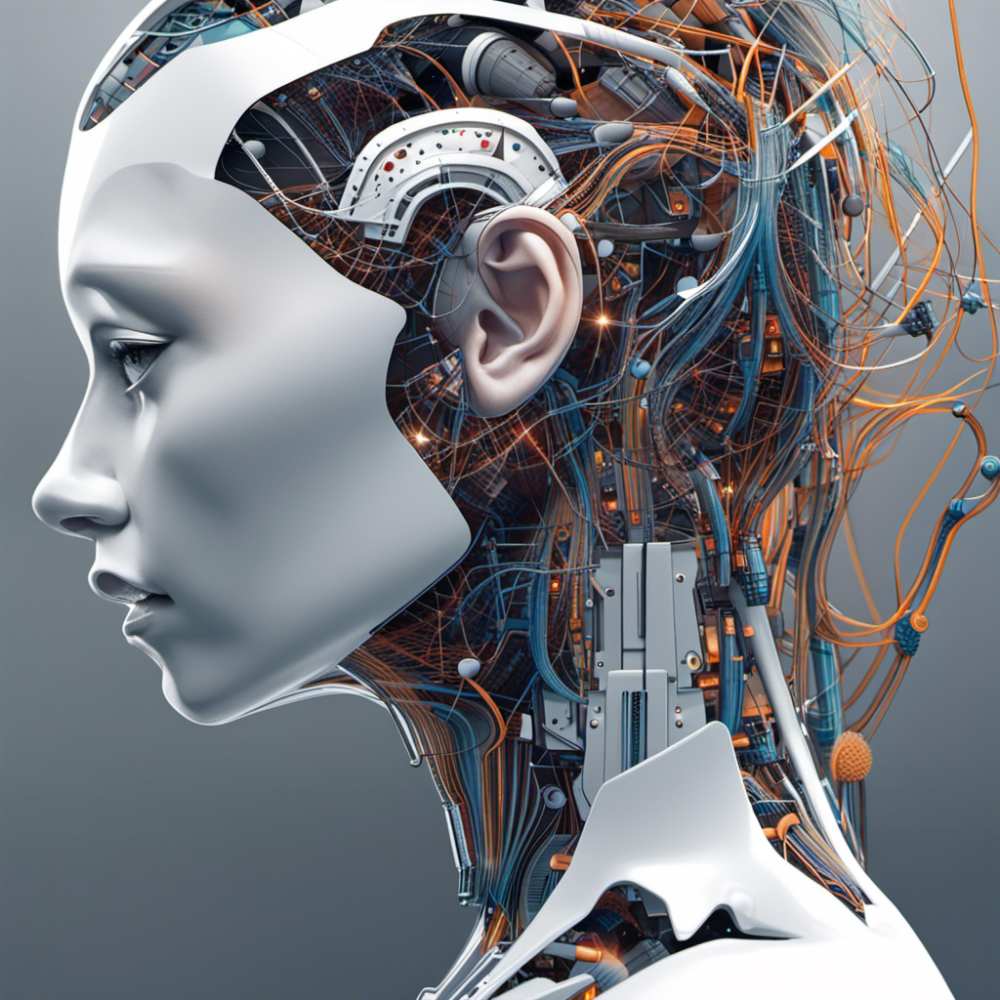

In [12]:
output = deployed_model.predict(GenerationRequest(text_prompts=[TextPrompt(text="Generative AI technical workshop")],
                                            style_preset="enhance", # "origami",
                                            seed = 31,
                                            height = 1024,
                                            width = 1024
                                             ))

decode_and_show(output)


SDXL can render short snippets of text, like single words. Let's try an example below.

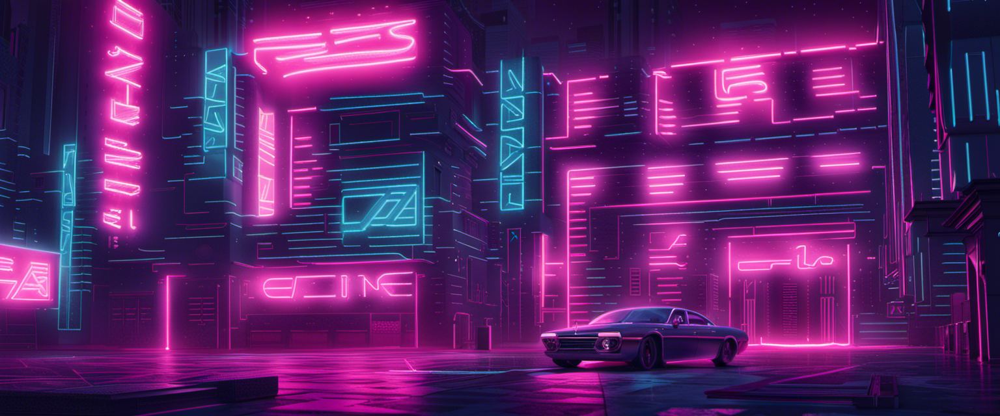

In [13]:
text1 = "AWS written in neon lights"
text2 = "Generative written in blue lights"
text3 = "AI written in green lights"

output = deployed_model.predict(GenerationRequest(text_prompts=[TextPrompt(text=text1, weight=10.9), TextPrompt(text=text2, weight=4.9), TextPrompt(text=text3, weight=0.9)],
                                            style_preset="neon-punk", # "neon-punk",
                                            seed=50,
                                            height=640,
                                            width=1536,
                                            sampler="DDIM",
                                             ))
decode_and_show(output)

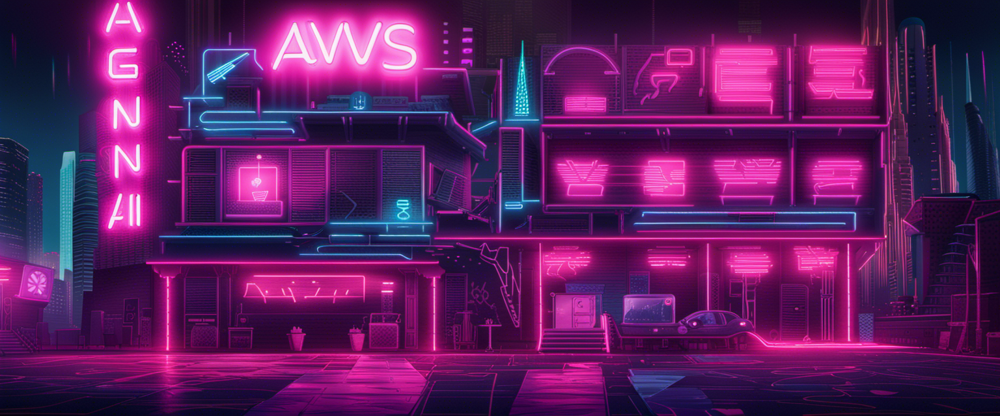

In [14]:
text = "'AWS-Gen-AI' written in neon lights"

output = deployed_model.predict(GenerationRequest(text_prompts=[TextPrompt(text=text)],
                                            style_preset="neon-punk",
                                            seed=50,
                                            height=640,
                                            width=1536,
                                            sampler="DDIM",
                                             ))
decode_and_show(output)

In [15]:
text= 'The Bag is a small sports weekender bag suitable for exercise or outdoor activities, and uses a luxurious and solid fabric with a subtle gloss to create a casual yet luxurious mood. It is easy to store small belongings and various pockets are provided.'

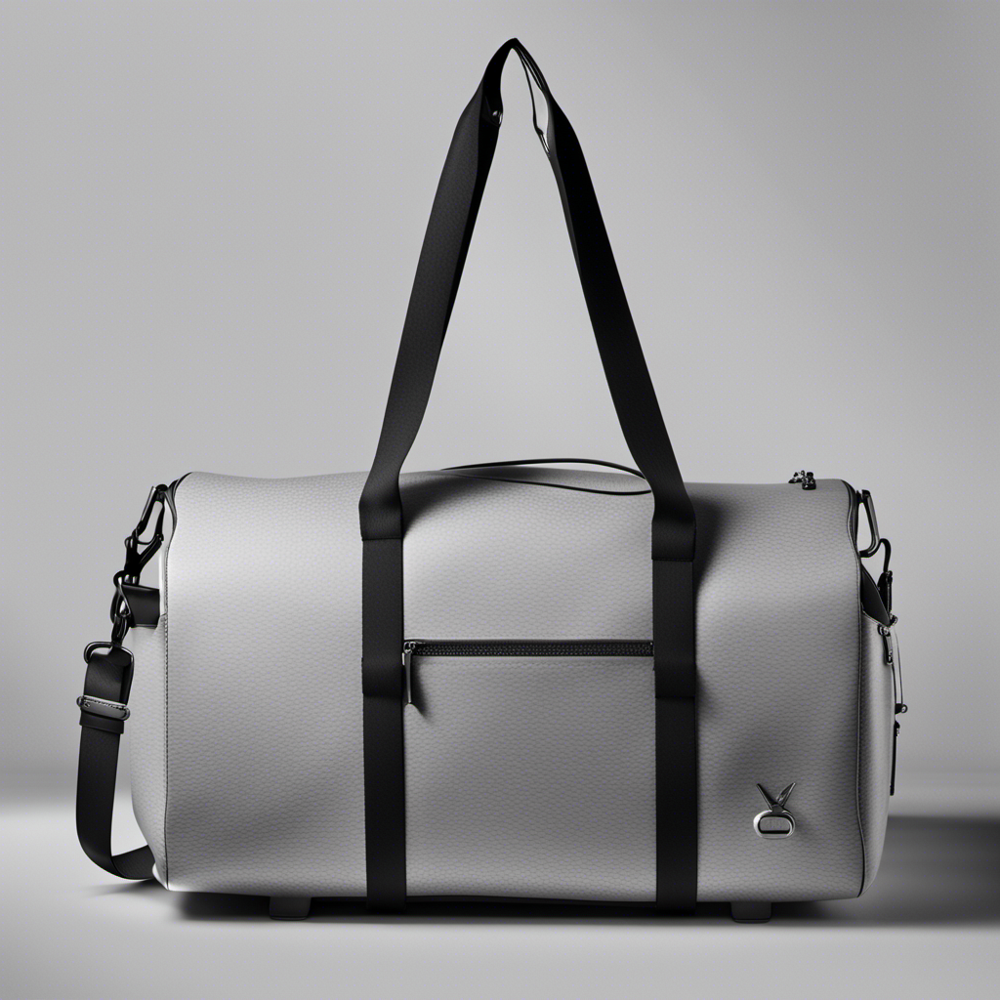

In [16]:
output = deployed_model.predict(GenerationRequest(text_prompts=[TextPrompt(text=text)],
                                            style_preset="enhance", # "origami",
                                            seed = 132,
                                            height = 1024,
                                            width = 1024
                                             ))

decode_and_show(output)


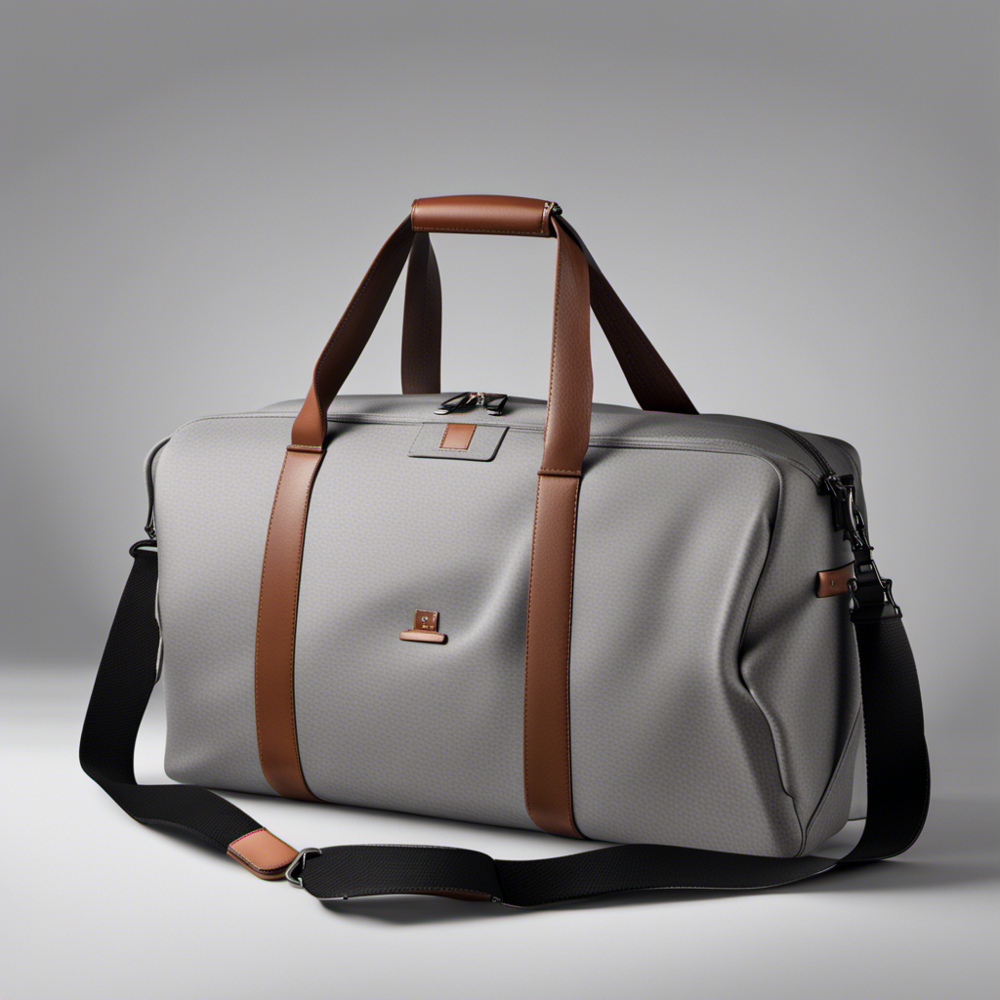

In [17]:
output = deployed_model.predict(GenerationRequest(text_prompts=[TextPrompt(text=text)],
                                            style_preset="enhance", # "origami",
                                            seed = 3,
                                            height = 1024,
                                            width = 1024
                                             ))

decode_and_show(output)


## <a id='toc4_2_'></a>[B: Image to image](#toc0_)

To perform inference that takes an image as input, you must pass the image into `init_image` as a base64-encoded string. Like output images, input images must be one of the supported resolutions: i.e. (height, width) should be one of   (1024, 1024), (1152, 896), (896, 1152), (1216, 832), (832, 1216), (1344, 768), (768, 1344), (1536, 640), (640, 1536).


Below is a helper function for converting images to base64-encoded strings:

In [18]:
def encode_image(image_path: str, resize: bool = True, size: Tuple[int, int] = (1024, 1024)) -> Union[str, None]:
    """
    Encode an image as a base64 string, optionally resizing it to a supported resolution.

    Args:
        image_path (str): The path to the image file.
        resize (bool, optional): Whether to resize the image. Defaults to True.

    Returns:
        Union[str, None]: The encoded image as a string, or None if encoding failed.
    """
    assert os.path.exists(image_path)

    if resize:
        image = Image.open(image_path)
        image = image.resize(size)
        image.save("image_path_resized.png")
        image_path = "image_path_resized.png"
    image = Image.open(image_path)
    assert image.size == size
    with open(image_path, "rb") as image_file:
        img_byte_array = image_file.read()
        # Encode the byte array as a Base64 string
        try:
            base64_str = base64.b64encode(img_byte_array).decode("utf-8")
            return base64_str
        except Exception as e:
            print(f"Failed to encode image {image_path} as base64 string.")
            print(e)
            return None
    

Let's feed an image into the model as well as the prompt this time. We can set `image_scale` to weight the relative importance of the image and the prompt. For the demo, we'll use a [picture of the cat, taken from Wikimedia Commons](https://commons.wikimedia.org/wiki/File:Cat_August_2010-4.jpg), provided along with this notebook.

In [19]:
!wget https://platform.stability.ai/Cat_August_2010-4.jpg

--2023-11-02 12:03:09--  https://platform.stability.ai/Cat_August_2010-4.jpg
Resolving platform.stability.ai (platform.stability.ai)... 104.18.34.224, 172.64.153.32, 2606:4700:4400::6812:22e0, ...
Connecting to platform.stability.ai (platform.stability.ai)|104.18.34.224|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 28624 (28K) [image/jpeg]
Saving to: ‘Cat_August_2010-4.jpg.3’

Cat_August_2010-4.j 100%[===================>]  27.95K  --.-KB/s    in 0s      

2023-11-02 12:03:09 (89.7 MB/s) - ‘Cat_August_2010-4.jpg.3’ saved [28624/28624]



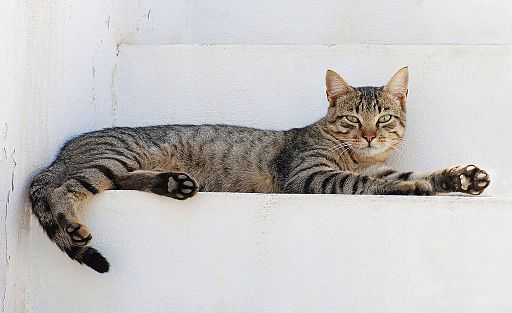

In [20]:
# Here is the original image:
display(Image.open('Cat_August_2010-4.jpg'))

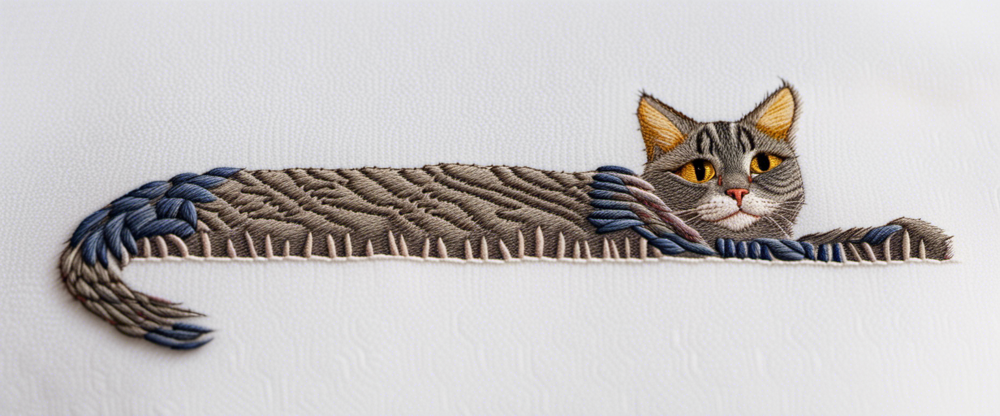

In [21]:
cat_path = "Cat_August_2010-4.jpg"

size = (1536, 640)
cat_data = encode_image(cat_path, size=size)

output = deployed_model.predict(GenerationRequest(text_prompts=[TextPrompt(text="cat in embroidery")],
                                                  init_image= cat_data,
                                                  cfg_scale=9,
                                                  image_strength=0.8,
                                                  seed=42,
                                                  height=size[0],
                                                  width=size[1],
                                                  init_image_mode="STEP_SCHEDULE"
                                                  ))
decode_and_show(output)



In [22]:
cat_path="./data/sweater.jpg"

In [23]:
image = Image.open(cat_path)
newsize_image = image.resize((1152, 832))


In [24]:
newsize_image.save('./data/new_sweater.jpg')

In [25]:
newcat_path = './data/new_sweater.jpg'

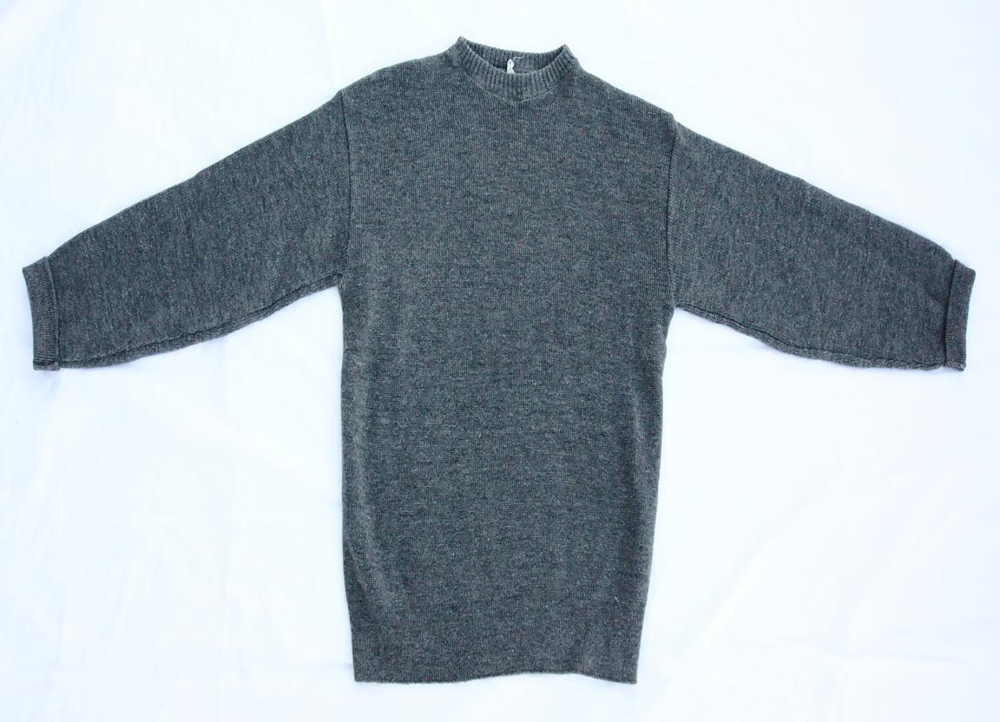

In [26]:
image = Image.open(newcat_path)
display(image)

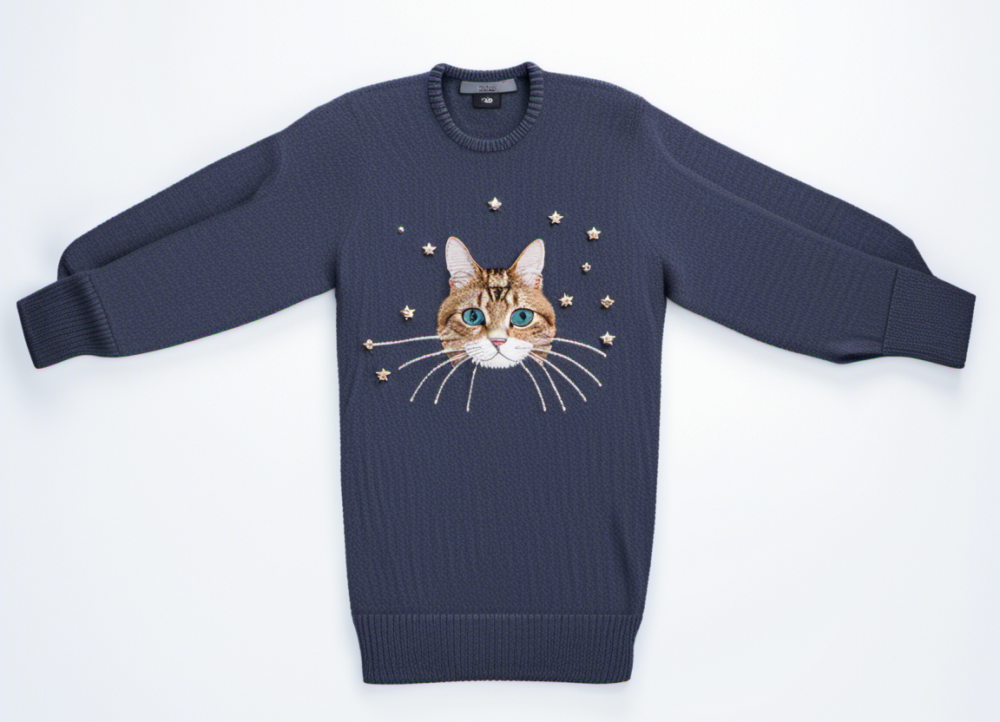

In [27]:
size = (1536, 640)
size = (960, 960)
size = (1152, 832)
cat_data = encode_image(newcat_path, size=size)

# text_prompts[0][text]= "A lighthouse on a cliff"
# text_prompts[0][weight]= 0.5
# text_prompts[1][text]="land, ground, dirt, grass"
# text_prompts[1][weight] = -0.9

 # ((((center image should change to cat and dog)))),

# best quality,botanic garden with extremely (hateful and [EMOTION]: 10.5) nature,([TIME]: 5.0),([SEASON]: 7.5),([WEATHER]: 2.0),illustration, atmosphere lighting,wide angle,by Otto Dix,hyperrealistic,psychedelic,([ANIMAL])

output = deployed_model.predict(GenerationRequest(text_prompts=[TextPrompt(text='Sweater with cat embroidery', weight=1.8)],
                                                  # clip_guidance_preset='SLOWEST',
                                                  style_preset="enhance", # "origami"enhance,
                                                  sampler="K_DPMPP_2M",
                                                  init_image= cat_data,
                                                  cfg_scale=8,
                                                  image_strength=0.2,
                                                  seed=30,
                                                  height=size[0],
                                                  width=size[1],
                                                  samples=1
                                                  ))
decode_and_show(output)

# <a id='toc5_'></a>[3: Delete the endpoint](#toc0_)

When you've finished working, you can delete the endpoint to release the EC2 instance(s) associated with it, and stop billing.

Get your list of Sagemaker endpoints using the AWS Sagemaker CLI like this:

In [ ]:
!aws sagemaker list-endpoints

# Delete an endpoint

In [ ]:
#deployed_model.sagemaker_session.delete_endpoint(endpoint_name)

# Rerun the aws cli command above to confirm that its gone.